<a href="https://colab.research.google.com/github/novoblake/AlgortihmsAndDataStructures/blob/master/FCDSN_DC_Demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title ## FCDSN-DC Demo

(c) DI Dominik Hirner BSc.
Institute for graphics and vision (ICG)
University of Technology Graz, Austria
E-mail: dominik.hirner@icg.tugraz.at .

This is a demo of our ccurate and lightweight end-to-end trainable CNN for stereo estimation with depth completion published at the ICPR 2022 conference.

If you find this helpful please check out our paper: https://arxiv.org/abs/XXXXXXX.XXX

Our full implementation can be found at: https://github.com/thedodo/FC-DCNN2

Find the original implementation at:
https://colab.research.google.com/drive/1i5k-YTCsmQC8IIURBh802oKeyZP_ZSHG

In [ ]:
#@title ## Import python packages
import sys
import numpy as np
import cv2
import re
import numpy.matlib
from PIL import Image

import torch
import torch.nn as nn
from torch.autograd import Variable
import argparse

In [ ]:
#@title ##define deformable convolution layer
class DeformConv2D(nn.Module):
    def __init__(self, inc, outc, kernel_size=3, padding=1, bias=None):
        super(DeformConv2D, self).__init__()
        self.kernel_size = kernel_size
        self.padding = padding
        self.zero_padding = nn.ZeroPad2d(padding)
        self.conv_kernel = nn.Conv2d(inc, outc, kernel_size=kernel_size, stride=kernel_size, bias=bias)

    def forward(self, x, offset):
        dtype = offset.data.type()
        ks = self.kernel_size
        N = offset.size(1) // 2

        # Change offset's order from [x1, x2, ..., y1, y2, ...] to [x1, y1, x2, y2, ...]
        # Codes below are written to make sure same results of MXNet implementation.
        # You can remove them, and it won't influence the module's performance.

        if self.padding:
            x = self.zero_padding(x)

        # (b, 2N, h, w)
        p = self._get_p(offset, dtype)

        # (b, h, w, 2N)
        p = p.contiguous().permute(0, 2, 3, 1)
        q_lt = Variable(p.data, requires_grad=False).floor()
        q_rb = q_lt + 1

        q_lt = torch.cat([torch.clamp(q_lt[..., :N], 0, x.size(2)-1), torch.clamp(q_lt[..., N:], 0, x.size(3)-1)], dim=-1).long()
        q_rb = torch.cat([torch.clamp(q_rb[..., :N], 0, x.size(2)-1), torch.clamp(q_rb[..., N:], 0, x.size(3)-1)], dim=-1).long()
        q_lb = torch.cat([q_lt[..., :N], q_rb[..., N:]], -1)
        q_rt = torch.cat([q_rb[..., :N], q_lt[..., N:]], -1)

        # (b, h, w, N)
        mask = torch.cat([p[..., :N].lt(self.padding)+p[..., :N].gt(x.size(2)-1-self.padding),
                          p[..., N:].lt(self.padding)+p[..., N:].gt(x.size(3)-1-self.padding)], dim=-1).type_as(p)
        mask = mask.detach()
        floor_p = p - (p - torch.floor(p))
        p = p*(1-mask) + floor_p*mask
        p = torch.cat([torch.clamp(p[..., :N], 0, x.size(2)-1), torch.clamp(p[..., N:], 0, x.size(3)-1)], dim=-1)

        # bilinear kernel (b, h, w, N)
        g_lt = (1 + (q_lt[..., :N].type_as(p) - p[..., :N])) * (1 + (q_lt[..., N:].type_as(p) - p[..., N:]))
        g_rb = (1 - (q_rb[..., :N].type_as(p) - p[..., :N])) * (1 - (q_rb[..., N:].type_as(p) - p[..., N:]))
        g_lb = (1 + (q_lb[..., :N].type_as(p) - p[..., :N])) * (1 - (q_lb[..., N:].type_as(p) - p[..., N:]))
        g_rt = (1 - (q_rt[..., :N].type_as(p) - p[..., :N])) * (1 + (q_rt[..., N:].type_as(p) - p[..., N:]))

        # (b, c, h, w, N)
        x_q_lt = self._get_x_q(x, q_lt, N)
        x_q_rb = self._get_x_q(x, q_rb, N)
        x_q_lb = self._get_x_q(x, q_lb, N)
        x_q_rt = self._get_x_q(x, q_rt, N)

        # (b, c, h, w, N)
        x_offset = g_lt.unsqueeze(dim=1) * x_q_lt + \
                   g_rb.unsqueeze(dim=1) * x_q_rb + \
                   g_lb.unsqueeze(dim=1) * x_q_lb + \
                   g_rt.unsqueeze(dim=1) * x_q_rt

        x_offset = self._reshape_x_offset(x_offset, ks)
        out = self.conv_kernel(x_offset)

        return out

    def _get_p_n(self, N, dtype):
        p_n_x, p_n_y = np.meshgrid(range(-(self.kernel_size-1)//2, (self.kernel_size-1)//2+1),
                          range(-(self.kernel_size-1)//2, (self.kernel_size-1)//2+1), indexing='ij')
        # (2N, 1)
        p_n = np.concatenate((p_n_x.flatten(), p_n_y.flatten()))
        p_n = np.reshape(p_n, (1, 2*N, 1, 1))
        p_n = Variable(torch.from_numpy(p_n).type(dtype), requires_grad=False)

        return p_n

    @staticmethod
    def _get_p_0(h, w, N, dtype):
        p_0_x, p_0_y = np.meshgrid(range(1, h+1), range(1, w+1), indexing='ij')
        p_0_x = p_0_x.flatten().reshape(1, 1, h, w).repeat(N, axis=1)
        p_0_y = p_0_y.flatten().reshape(1, 1, h, w).repeat(N, axis=1)
        p_0 = np.concatenate((p_0_x, p_0_y), axis=1)
        p_0 = Variable(torch.from_numpy(p_0).type(dtype), requires_grad=False)

        return p_0

    def _get_p(self, offset, dtype):
        N, h, w = offset.size(1)//2, offset.size(2), offset.size(3)

        # (1, 2N, 1, 1)
        p_n = self._get_p_n(N, dtype)
        # (1, 2N, h, w)
        p_0 = self._get_p_0(h, w, N, dtype)
        p = p_0 + p_n + offset
        return p

    def _get_x_q(self, x, q, N):
        b, h, w, _ = q.size()
        padded_w = x.size(3)
        c = x.size(1)
        # (b, c, h*w)
        x = x.contiguous().view(b, c, -1)

        # (b, h, w, N)
        index = q[..., :N]*padded_w + q[..., N:]  # offset_x*w + offset_y
        # (b, c, h*w*N)
        index = index.contiguous().unsqueeze(dim=1).expand(-1, c, -1, -1, -1).contiguous().view(b, c, -1)

        x_offset = x.gather(dim=-1, index=index).contiguous().view(b, c, h, w, N)

        return x_offset

    @staticmethod
    def _reshape_x_offset(x_offset, ks):
        b, c, h, w, N = x_offset.size()
        x_offset = torch.cat([x_offset[..., s:s+ks].contiguous().view(b, c, h, w*ks) for s in range(0, N, ks)], dim=-1)
        x_offset = x_offset.contiguous().view(b, c, h*ks, w*ks)

        return x_offset

In [ ]:
#@title ##Create feature extraction NW

num_conv_feature_maps = 60
class SiameseBranch64(nn.Module):
    def __init__(self,img_ch=3):
        super(SiameseBranch64,self).__init__()

        #self.conv_offset = nn.Conv2d(img_ch, 18, kernel_size=3, padding=1, bias=None)
        #self.deform_conv = DeformConv2D(img_ch, img_ch, padding=1)

        self.Tanh = nn.Tanh()
        self.Conv1 = nn.Conv2d(img_ch, num_conv_feature_maps, kernel_size = 3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv2 = nn.Conv2d(num_conv_feature_maps, num_conv_feature_maps, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv3 = nn.Conv2d(2*num_conv_feature_maps, num_conv_feature_maps, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv4 = nn.Conv2d(3*num_conv_feature_maps, num_conv_feature_maps, kernel_size=3,stride=1,padding = 1,dilation = 1,bias=True)


    def forward(self,x_in):

        #maybe also for input? let us try it!
        #deform_conv block!

        #offsets = self.conv_offset(x_in)
        #x_in = self.deform_conv(x_in,offsets)

        x1 = self.Conv1(x_in)
        x1 = self.Tanh(x1)

        x2 = self.Conv2(x1)
        x2 = self.Tanh(x2)

        d2 = torch.cat((x1,x2),dim=1)

        x3 = self.Conv3(d2)
        x3 = self.Tanh(x3)

        d3 = torch.cat((x1,x2,x3),dim=1)

        x4 = self.Conv4(d3)
        #DEFORM BLOCK HERE NEEDS TOO MUCH GPU!!!(way too much)

        return x4

branch = SiameseBranch64()
branch = branch.cuda()


In [ ]:
#@title ##create similarity function NW
conv_sim_tanh = 40
class SimMeasTanh(nn.Module):
    def __init__(self,img_ch=2*num_conv_feature_maps):
        super(SimMeasTanh,self).__init__()

        self.tanh = nn.Tanh()
        #self.tanh = nn.Sigmoid()

        self.Conv1 = nn.Conv2d(img_ch, conv_sim_tanh, kernel_size = 3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv2 = nn.Conv2d(conv_sim_tanh, conv_sim_tanh, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv3 = nn.Conv2d(2*conv_sim_tanh, conv_sim_tanh, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv4 = nn.Conv2d(3*conv_sim_tanh, conv_sim_tanh, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv5 = nn.Conv2d(4*conv_sim_tanh, 1, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)

        #why does the output need to be 18?? who knows..
        #everything else not possible with GPU-RAM! Come up with new network structure?
        #maybe the sim.meas does not need to be fully densely conn.?
        self.conv_offset = nn.Conv2d(1, 18, kernel_size=3, padding=1, bias=None)
        self.deform_conv = DeformConv2D(1, 1, padding=1)

    def forward(self,x_in):

        x1 = self.Conv1(x_in)
        x1 = self.tanh(x1)

        x2 = self.Conv2(x1)
        x2 = self.tanh(x2)

        d1 = torch.cat((x1,x2),dim=1)


        x3 = self.Conv3(d1)
        x3 = self.tanh(x3)

        d2 = torch.cat((x1,x2,x3),dim=1)

        x4 = self.Conv4(d2)
        x4 = self.tanh(x4)
        d3 = torch.cat((x1,x2,x3,x4),dim=1)
        x5 = self.Conv5(d3)
        #needs to be positive for BCE!!!
        x5 = self.tanh(x5)

        #deform_conv block!
        offsets = self.conv_offset(x5)
        x6 = self.deform_conv(x5,offsets)

        return x6

simB = SimMeasTanh()
simB = simB.cuda()

In [ ]:
#@title ##create update Incons NW
n_conv_st1 = 70
chan = 10
class UpdateInconsNW(nn.Module):
    def __init__(self,img_ch=chan):
        super(UpdateInconsNW,self).__init__()

        self.softmax = nn.Softmax(dim=1)

        self.act = nn.ReLU()

        self.Conv1 = nn.Conv2d(img_ch, n_conv_st1, kernel_size = 3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv2 = nn.Conv2d(n_conv_st1, n_conv_st1, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)
        self.Conv4 = nn.Conv2d(n_conv_st1 + 3, img_ch, kernel_size=3,stride=1,padding = 1,dilation = 1, bias=True)


    def forward(self,x_in, im):

        x1 = self.Conv1(x_in)
        x1 = self.act(x1)

        x2 = self.Conv2(x1)
        x2 = self.act(x2)

        x3im = torch.cat((x2,im),axis = 1)

        x4 = self.Conv4(x3im)
        x5 = self.softmax(x4)

        return x5

updInc = UpdateInconsNW()
updInc = updInc.cuda()

## Run all the helper functions beneath
These helper functions perform the following tasks

* Create the cost volume (left and right)
* Filter the cost volume with median
* Check for and delete inconsistencies
* Shift incons disparity
* Update Inconsisten points

(You can look at the code if you double-click into the cell)

In [ ]:
#@title ####Run Me
def createShiftPytZero(image):

    counter = np.ones((image.shape[0],image.shape[1])) * chan
    counterT = Variable(Tensor(counter))

    shift_arr = np.zeros((chan,image.shape[0],image.shape[1]))
    shift_arrT = Variable(Tensor(shift_arr))

    i = 0
    while(torch.sum(counterT) > 0):

        if(i == image.shape[1]):
            i = 0

        if(i % 2 == 0):
            ex_s = torch.roll(image,-i)
            ex_s[:,chan-i:chan] = 0

        if(i % 2 == 1):
            ex_s = torch.roll(image,i)
            ex_s[:,0:i] = 0


        idc = torch.nonzero(ex_s, as_tuple = True)

        counterT[idc[0],idc[1]] += -1

        max_loop = torch.min(counterT).cpu().data.numpy().astype(np.int)

        #it overwrites lines that already have values with 0's!!!
        for d in range(max_loop,chan):

            idx_cur = torch.where(counterT == d)
            slice_tensor = torch.zeros(ex_s.shape[0], ex_s.shape[1]).cuda()
            slice_tensor[idx_cur[0].long(),idx_cur[1].long()] = ex_s[idx_cur[0].long(),idx_cur[1].long()]

            idc_slice = torch.nonzero(slice_tensor, as_tuple = True)
            shift_arrT[d, idc_slice[0].long(),idc_slice[1].long()] = ex_s[idc_slice[0].long(),idc_slice[1].long()]

        counterT[counterT < 0] = 0
        i = i + 1

    return shift_arrT


In [ ]:
#@title ####Run Me
def TestFillIncons(nr_iter, disp, im_left):

    disp[np.isnan(disp)] = 0
    disp[np.isinf(disp)] = 0


    im = cv2.imread(im_left)
    im = (im - np.min(im)) / (np.max(im) - np.min(im))

    h,w,c = im.shape
    im = np.reshape(im, (c,h, w))
    im = im[np.newaxis,...]
    imT = Variable(Tensor(im.astype(np.uint8)))

    upd = np.zeros((disp.shape[0],disp.shape[1]))
    upd[np.where(disp == 0)] = 1

    keep = np.zeros((disp.shape[0],disp.shape[1]))
    keep[np.where(upd == 0)] = 1

    keep_t = disp * keep

    updT = Variable(Tensor(upd.astype(np.float32)))
    keepT_t = Variable(Tensor(keep_t.astype(np.float32)))

    dispT = Variable(Tensor(disp.astype(np.uint8)))

    for d in range(0,nr_iter):

        dispShift = createShiftPytZero(dispT)
        dispShift = dispShift.unsqueeze(0)

        OutT = updInc(dispShift,imT)
        OutT = torch.squeeze(OutT)

        bs,c,x,y = dispShift.shape

        idc_for_updt = torch.argmax(OutT, axis=0).unsqueeze(0)
        pred = torch.gather(np.squeeze(dispShift), 0, idc_for_updt).squeeze()

        updT_t = pred * updT
        final_outp = keepT_t + updT_t


    disp_arr = final_outp.cpu().data.numpy().astype(np.float32)
    #disp_arr = cv2.medianBlur(disp_arr,5)
    return disp_arr


In [ ]:
#@title ####Run Me
def readPFM(file):
    file = open(file, 'rb')

    color = None
    width = None
    height = None
    scale = None
    endian = None

    header = file.readline().decode('utf-8').rstrip()
    if header == 'PF':
        color = True
    elif header == 'Pf':
        color = False
    else:
        raise Exception('Not a PFM file.')

    dim_match = re.match(r'^(\d+)\s(\d+)\s$', file.readline().decode('utf-8'))
    if dim_match:
        width, height = map(int, dim_match.groups())
    else:
        raise Exception('Malformed PFM header.')

    scale = float(file.readline().decode('utf-8').rstrip())
    if scale < 0:  # little-endian
        endian = '<'
        scale = -scale
    else:
        endian = '>'  # big-endian

    data = np.fromfile(file, endian + 'f')
    shape = (height, width, 3) if color else (height, width)

    data = np.reshape(data, shape)
    data = np.flipud(data)
    return data, scale

Tensor = torch.cuda.FloatTensor
LongTensor = torch.cuda.LongTensor


In [ ]:
#@title ####Run Me
from typing import Tuple

import torch
import torch.nn as nn
import torch.nn.functional as F

def _compute_binary_kernel(window_size: Tuple[int, int]) -> torch.Tensor:
    r"""Creates a binary kernel to extract the patches. If the window size
    is HxW will create a (H*W)xHxW kernel.
    """
    window_range: int = window_size[0] * window_size[1]
    kernel: torch.Tensor = torch.zeros(window_range, window_range)
    for i in range(window_range):
        kernel[i, i] += 1.0
    return kernel.view(window_range, 1, window_size[0], window_size[1])


def _compute_zero_padding(kernel_size: Tuple[int, int]) -> Tuple[int, int]:
    r"""Utility function that computes zero padding tuple."""
    computed: Tuple[int, ...] = tuple([(k - 1) // 2 for k in kernel_size])
    return computed[0], computed[1]


class MedianBlur(nn.Module):
    r"""Blurs an image using the median filter.

    Args:
        kernel_size (Tuple[int, int]): the blurring kernel size.

    Returns:
        torch.Tensor: the blurred input tensor.

    Shape:
        - Input: :math:`(B, C, H, W)`
        - Output: :math:`(B, C, H, W)`

    Example:
        >>> input = torch.rand(2, 4, 5, 7)
        >>> blur = kornia.filters.MedianBlur((3, 3))
        >>> output = blur(input)  # 2x4x5x7
    """

    def __init__(self, kernel_size: Tuple[int, int]) -> None:
        super(MedianBlur, self).__init__()
        self.kernel: torch.Tensor = _compute_binary_kernel(kernel_size)
        self.padding: Tuple[int, int] = _compute_zero_padding(kernel_size)

    def forward(self, input: torch.Tensor):  # type: ignore
        if not torch.is_tensor(input):
            raise TypeError("Input type is not a torch.Tensor. Got {}"
                            .format(type(input)))
        if not len(input.shape) == 4:
            raise ValueError("Invalid input shape, we expect BxCxHxW. Got: {}"
                             .format(input.shape))
        # prepare kernel
        b, c, h, w = input.shape
        tmp_kernel: torch.Tensor = self.kernel.to(input.device).to(input.dtype)
        kernel: torch.Tensor = tmp_kernel.repeat(c, 1, 1, 1)

        # map the local window to single vector
        features: torch.Tensor = F.conv2d(
            input, kernel, padding=self.padding, stride=1, groups=c)
        features = features.view(b, c, -1, h, w)  # BxCx(K_h * K_w)xHxW

        # compute the median along the feature axis
        median: torch.Tensor = torch.median(features, dim=2)[0]
        return median


In [ ]:
#@title ####Run Me
def median_blur(input: torch.Tensor,
                kernel_size: Tuple[int, int]) -> torch.Tensor:
    r"""Blurs an image using the median filter.

    See :class:`~kornia.filters.MedianBlur` for details.
    """
    return MedianBlur(kernel_size)(input)


def filterCostVolMedianPyt(cost_vol):

    d,h,w = cost_vol.shape
    cost_vol = cost_vol.unsqueeze(0)

    for disp in range(d):

        cost_vol[:,disp,:,:] = median_blur(cost_vol[:,disp,:,:].unsqueeze(0), (5,5))

    return torch.squeeze(cost_vol)


In [ ]:
#@title ####Run Me
%%capture
!pip install guided-filter-pytorch
!pip install plyfile
!pip install pypotree
from guided_filter_pytorch.guided_filter import GuidedFilter
import math
def filterCostVolBilatpyt(cost_vol,left):

    left = np.mean(left,axis=2)
    leftT = Variable(Tensor(left))
    leftT = leftT.unsqueeze(0).unsqueeze(0)

    d,h,w = cost_vol.shape

    f = GuidedFilter(8,10).cuda()  #10 #0.001

    for disp in range(d):
        cur_slice =  cost_vol[disp,:,:]
        cur_slice = cur_slice.unsqueeze(0).unsqueeze(0)

        inputs = [leftT, cur_slice]

        test = f(*inputs)
        cost_vol[disp,:,:] = np.squeeze(test)

    return cost_vol


In [ ]:
#@title ####Run Me
def LR_Check(first_output, second_output):

    h,w = first_output.shape

    line = np.array(range(0, w))
    idx_arr = np.matlib.repmat(line,h,1)

    dif = idx_arr - first_output

    first_output[np.where(dif <= 0)] = 0

    first_output = first_output.astype(np.int)
    second_output = second_output.astype(np.int)
    dif = dif.astype(np.int)

    second_arr_reordered = np.array(list(map(lambda x, y: y[x], dif, second_output)))

    dif_LR = np.abs(second_arr_reordered - first_output)
    first_output[np.where(dif_LR >= 1.1)] = 0

    first_output = first_output.astype(np.float32)
    first_output[np.where(first_output == 0.0)] = np.nan

    #only for MB!
#    if(dataset == 'MB' or dataset == 'MBTest'):
#        first_output[np.where(first_output <= 18)] = np.nan
    #KITTItest ?
#    if(dataset == 'KITTI2012' or dataset == 'KITTI2015'):
#        first_output[np.where(first_output <= 2)] = np.nan

    return first_output


In [ ]:
#@title ####Run Me
def createCostVol(left_im,right_im,max_disp):

    a_h, a_w,c = left_im.shape

    left_im = np.transpose(left_im, (2,0,1)).astype(np.uint8)
    right_im = np.transpose(right_im, (2,0,1)).astype(np.uint8)

    left_im = np.reshape(left_im, [1,c,a_h,a_w])
    right_im = np.reshape(right_im, [1,c,a_h,a_w])

    with torch.no_grad():

        left_imT = Variable(Tensor(left_im.astype(np.uint8)))
        right_imT = Variable(Tensor(right_im.astype(np.uint8)))

        left_feat = branch(left_imT)
        right_feat = branch(right_imT)

        _,f,h,w = left_feat.shape

        cost_vol = np.zeros((max_disp+1,a_h,a_w))
        cost_volT = Variable(Tensor(cost_vol))


        #0 => max_disp => one less disp!
        #python3 apparently cannot have 0 here for disp: right_shift = torch.cuda.FloatTensor(1,f,h,disp).fill_(0)
        for disp in range(0,max_disp+1):

            if(disp == 0):

                sim_score = simB(torch.cat((left_feat, right_feat),dim=1))
                cost_volT[disp,:,:] = torch.squeeze(sim_score)
            else:
                right_shifted = torch.cuda.FloatTensor(1,f,h,w).fill_(0)
                right_shift = torch.cuda.FloatTensor(1,f,h,disp).fill_(0)
                right_appended = torch.cat([right_shift,right_feat],3)

                _,f,h_ap,w_ap = right_appended.shape
                right_shifted[:,:,:,:] = right_appended[:,:,:,:(w_ap-disp)]
                sim_score = simB(torch.cat((left_feat, right_shifted),dim=1))
                #sim_score = simB(torch.cat((right_shifted, left_feat),dim=1))

                cost_volT[disp,:,:] = torch.squeeze(sim_score)
    return cost_volT


In [ ]:
#@title ####Run Me
def createCostVolRL(left_im,right_im,max_disp):

    a_h, a_w,c = left_im.shape

    left_im = np.transpose(left_im, (2,0,1)).astype(np.uint8)
    right_im = np.transpose(right_im, (2,0,1)).astype(np.uint8)

    left_im = np.reshape(left_im, [1,c,a_h,a_w])
    right_im = np.reshape(right_im, [1,c,a_h,a_w])

    with torch.no_grad():

        left_imT = Variable(Tensor(left_im))
        right_imT = Variable(Tensor(right_im))

        left_feat = branch(left_imT)
        right_feat = branch(right_imT)


        _,f,h,w = left_feat.shape
        cost_vol = np.zeros((max_disp+1,a_h,a_w))

        cost_volT = Variable(Tensor(cost_vol))

        for disp in range(0,max_disp+1):

            if(disp == 0):
                sim_score = simB(torch.cat((left_feat, right_feat),dim=1))
                cost_volT[disp,:,:] = torch.squeeze(sim_score)
            else:
                left_shifted = torch.cuda.FloatTensor(1,f,h,w).fill_(0)
                left_shift = torch.cuda.FloatTensor(1,f,h,disp).fill_(0)
                left_appended = torch.cat([left_feat,left_shift],3)

                _,f,h_ap,w_ap = left_appended.shape
                left_shifted[:,:,:,:] = left_appended[:,:,:,disp:w_ap]

                sim_score = simB(torch.cat((left_shifted, right_feat),dim=1))
                cost_volT[disp,:,:] = torch.squeeze(sim_score)

    return cost_volT


In [ ]:
#@title ####Run Me
def TestImage(fn_left, fn_right, max_disp, filtered, lr_check):

    left = cv2.imread(fn_left)
    right = cv2.imread(fn_right)
    disp_map = []

    if(filtered):
        cost_vol = createCostVol(left,right,max_disp)
        #cost_vol_filteredn = filterCostVolMedianPyt(cost_vol)

        cost_vol_filteredn = filterCostVolBilatpyt(cost_vol,left)
        cost_vol_filteredn = np.squeeze(cost_vol_filteredn.cpu().data.numpy())
        disp = np.argmax(cost_vol_filteredn, axis=0)

        del cost_vol
        del cost_vol_filteredn
        torch.cuda.empty_cache()

        if(lr_check):
            cost_vol_RL = createCostVolRL(left,right,max_disp)
            #cost_vol_RL_fn = filterCostVolMedianPyt(cost_vol_RL)

            cost_vol_RL_fn = filterCostVolBilatpyt(cost_vol_RL,right)
            cost_vol_RL_fn = np.squeeze(cost_vol_RL_fn.cpu().data.numpy())

            disp_map_RL = np.argmax(cost_vol_RL_fn, axis=0)
            disp_map = LR_Check(disp.astype(np.float32), disp_map_RL.astype(np.float32))

            del cost_vol_RL
            del cost_vol_RL_fn
            torch.cuda.empty_cache()

    else:
        cost_vol = createCostVol(left,right,max_disp)
        cost_vol = np.squeeze(cost_vol.cpu().data.numpy())
        disp = np.argmax(cost_vol, axis=0)

        if(lr_check):

            cost_vol_RL = createCostVolRL(left,right,max_disp)
            cost_vol_RL = np.squeeze(cost_vol_RL.cpu().data.numpy())
            disp_map_RL = np.argmax(cost_vol_RL, axis=0)
            disp_map = LR_Check(disp.astype(np.float32), disp_map_RL.astype(np.float32))

    if(lr_check):
        return disp_map, disp, disp_map_RL
    else:
        return disp


In [ ]:
#@title ####Run Me
def writePFM(file, image, scale=1):
    file = open(file, 'wb')

    color = None

    if image.dtype.name != 'float32':
        raise Exception('Image dtype must be float32.')

    image = np.flipud(image)

    if len(image.shape) == 3 and image.shape[2] == 3:  # color image
        color = True
    elif len(image.shape) == 2 or len(image.shape) == 3 and image.shape[2] == 1:  # greyscale
        color = False
    else:
        raise Exception('Image must have H x W x 3, H x W x 1 or H x W dimensions.')

    file.write('PF\n'.encode() if color else 'Pf\n'.encode())
    file.write('%d %d\n'.encode() % (image.shape[1], image.shape[0]))

    endian = image.dtype.byteorder

    if endian == '<' or endian == '=' and sys.byteorder == 'little':
        scale = -scale

    file.write('%f\n'.encode() % scale)

    image.tofile(file)


In [ ]:
#@title ####Run Me
def writePFMcyt(file, image, scale=1):
    file = open(file, 'wb')

    color = None

    image = np.flipud(image)

    if len(image.shape) == 3 and image.shape[2] == 3:  # color image
        color = True
    elif len(image.shape) == 2 or len(image.shape) == 3 and image.shape[2] == 1:  # greyscale
        color = False
    else:
        raise Exception('Image must have H x W x 3, H x W x 1 or H x W dimensions.')

    file.write('PF\n'.encode() if color else 'Pf\n'.encode())
    file.write('%d %d\n'.encode() % (image.shape[1], image.shape[0]))

    endian = image.dtype.byteorder

    scale = -scale

    file.write('%f\n'.encode() % scale)

    image.tofile(file)



In [ ]:
#@markdown Run me
def write_ply(fn, verts, colors):
    verts = verts.reshape(-1, 3)
    colors = colors.reshape(-1, 3)
    verts = np.hstack([verts, colors])
    with open(fn, 'wb') as f:
        f.write((ply_header % dict(vert_num=len(verts))).encode('utf-8'))
        np.savetxt(f, verts, fmt='%f %f %f %d %d %d ')

In [ ]:
#@markdown Run me
from plyfile import PlyData
def cleanPLY(ply_path, ply_cleaned):

    plydata = PlyData.read(ply_path)

    x_arr = np.array(plydata.elements[0].data['x'])
    y_arr = np.array(plydata.elements[0].data['y'])
    z_arr = np.array(plydata.elements[0].data['z'])


    r_arr = np.array(plydata.elements[0].data['red'])
    g_arr = np.array(plydata.elements[0].data['green'])
    b_arr = np.array(plydata.elements[0].data['blue'])

    high = np.percentile(z_arr,99.5)
    low = np.percentile(z_arr, 2)

    idx_bad_pos = np.where(z_arr > high)
    idx_bad_neg = np.where(z_arr < low)

    idx_bad = np.concatenate((idx_bad_pos, idx_bad_neg), axis=1)[0]

    x_arr_new = np.delete(x_arr, idx_bad)
    y_arr_new = np.delete(y_arr, idx_bad)
    z_arr_new = np.delete(z_arr, idx_bad)

    r_arr_new = np.delete(r_arr, idx_bad)
    g_arr_new = np.delete(g_arr, idx_bad)
    b_arr_new = np.delete(b_arr, idx_bad)


    points = []
    for pt_count in range(0, len(x_arr_new)):

        points.append("%f %f %f %d %d %d 0\n"%(x_arr_new[pt_count] ,y_arr_new[pt_count] ,z_arr_new[pt_count] ,r_arr_new[pt_count] ,g_arr_new[pt_count], b_arr_new[pt_count]))


    file = open(ply_cleaned,"w")
    file.write('''ply
    format ascii 1.0
    element vertex %d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    property uchar alpha
    end_header
    %s
    '''%(len(x_arr_new),"".join(points)))

    file.close()

## Try Middlebury example</h4></center>
(can take a bit of time depending on internet speed and available GPU's)


In [ ]:
#do not save pfm (takes time)
#plot three results!!
Example = 'Teddy' #@param ["Adirondack", "Art", "Jadeplant", "Motorcycle", "Piano", "Playroom", "Teddy"] {allow-input: false}
display_pointcloud = True #@param {type:"boolean"}


my_file_id = "1Bo3INQhCK1N17EuLkX7nnie46zHeqrQ2"
!gdown https://drive.google.com/uc?id={my_file_id}

branch.load_state_dict(torch.load('mb'))

my_file_id_simb = "1jJG3ZfjBRIrWzN2MQZ1TxC_9JWMh2l64"
!gdown https://drive.google.com/uc?id={my_file_id_simb}

simB.load_state_dict(torch.load('mb_simB'))

my_file_id_incons = "11DNIJmpCTZpmwEC-rrKjRmoHaUEEma-C"
!gdown https://drive.google.com/uc?id={my_file_id_incons}

updInc.load_state_dict(torch.load('Incons'))

if(Example == 'Adirondack'):
  left_id = "1MDLj2eHmb2VZTZ4pkVNFcQ9fycKfMRau"
  !gdown https://drive.google.com/uc?id={left_id}

  right_id = "1CCt3AfpWfRYmh1W1n0_EI0lLuPrYbAKB"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('adiron_left.png', 'adiron_right.png', 145, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'adiron_left.png')

  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('adiron_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')


if(Example == 'Art'):
  left_id = "1G0QiQWbLlNO6bWZtrSs355DSbbkezA9v"
  !gdown https://drive.google.com/uc?id={left_id}
  right_id = "1JoPI4-h0MzPq2oKnGyY1B7siXBtFWqvP"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('art_left.png', 'art_right.png', 130, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'art_left.png')

  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('art_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')

if(Example == 'Jadeplant'):
  left_id = "1eIBL6utO6FPJnWNql1GTeuwnIyhtQH-U"
  !gdown https://drive.google.com/uc?id={left_id}
  right_id = "1HgseF0tb7SBWLwfAWW0_rMmBvjG4wCoo"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('jade_left.png', 'jade_right.png', 320, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'jade_left.png')

  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('jade_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')


if(Example == 'Motorcycle'):
  left_id = "1qE-DzQEhL-PcJvvTrAo8onmjX4W5NXvl"
  !gdown https://drive.google.com/uc?id={left_id}
  right_id = "1Ah9xpM_ZsY-Saz-zwoO73-BwJ1f_zfAA"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('motor_left.png', 'motor_right.png', 140, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'motor_left.png')


  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('motor_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')

if(Example == 'Piano'):
  left_id = "1q9-vCWtMl9-hTmgXe2HvzCrTCafECDLH"
  !gdown https://drive.google.com/uc?id={left_id}
  right_id = "1WlWEBoL6vSaH78ijT2D6ju_zTsJv7GYb"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('piano_left.png', 'piano_right.png', 130, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'piano_left.png')

  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('piano_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')

if(Example == 'Playroom'):
  left_id = "1X87s5lpk2yEfpn0GMhG5DJ15JsArU1Yq"
  !gdown https://drive.google.com/uc?id={left_id}
  right_id = "1sZqbsjUudDtd-lCPFR0iqbsNfzdRiYPZ"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('playroom_left.png', 'playroom_right.png', 165, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'playroom_left.png')

  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('playroom_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')


if(Example == 'Teddy'):
  left_id = "1H-fVO59FI8wnQAIILPYvOoYrQloz1Eh4"
  !gdown https://drive.google.com/uc?id={left_id}
  right_id = "19kwr4XVdCX9pBTCJndJ_g4k4I_znFM5V"
  !gdown https://drive.google.com/uc?id={right_id}

  filtered = True
  lr_check = True
  disp_s, disp, disp_rl = TestImage('teddy_left.png', 'teddy_right.png', 165, filtered, lr_check)
  filled_disp = TestFillIncons(5, disp_s, 'teddy_left.png')

  if(display_pointcloud):

    ply_header = '''ply
    format ascii 1.0
    element vertex %(vert_num)d
    property float x
    property float y
    property float z
    property uchar red
    property uchar green
    property uchar blue
    end_header
    '''

    print('loading images...')

    imgL = cv2.imread('teddy_left.png')
    print('generating 3d point cloud...',)
    h, w = imgL.shape[:2]
    f = 0.8*w                          # guess for focal length
    Q = np.float32([[1, 0, 0, -0.5*w],
                    [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                    [0, 0, 0,     -f], # so that y-axis looks up
                    [0, 0, 1,      0]])


    disp = np.asarray(filled_disp)
    points = cv2.reprojectImageTo3D(disp, Q)
    colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
    mask = disp > disp.min()
    out_points = points[mask]
    out_colors = colors[mask]
    out_fn = 'out.ply'
    write_ply(out_fn, out_points, out_colors)
    print('%s saved' % out_fn)
    print('Done')
    cleanPLY('out.ply', 'out_cleaned.ply')


Downloading...
From: https://drive.google.com/uc?id=1Bo3INQhCK1N17EuLkX7nnie46zHeqrQ2
To: /content/mb
100% 786k/786k [00:00<00:00, 115MB/s]
Downloading...
From: https://drive.google.com/uc?id=1jJG3ZfjBRIrWzN2MQZ1TxC_9JWMh2l64
To: /content/mb_simB
100% 527k/527k [00:00<00:00, 103MB/s]
Downloading...
From: https://drive.google.com/uc?id=11DNIJmpCTZpmwEC-rrKjRmoHaUEEma-C
To: /content/Incons
100% 230k/230k [00:00<00:00, 90.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1H-fVO59FI8wnQAIILPYvOoYrQloz1Eh4
To: /content/teddy_left.png
100% 1.18M/1.18M [00:00<00:00, 133MB/s]
Downloading...
From: https://drive.google.com/uc?id=19kwr4XVdCX9pBTCJndJ_g4k4I_znFM5V
To: /content/teddy_right.png
100% 1.17M/1.17M [00:00<00:00, 65.6MB/s]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional inf

loading images...
generating 3d point cloud...
out.ply saved
Done


Run the cell beneath only if you checked display_pointcloud in the previous cell! It will display a generated point cloud using potree.
Beware that this takes a bit of time and ressources!

In [ ]:
import pypotree
plydata = PlyData.read('out_cleaned.ply')

x_arr = np.array(plydata.elements[0].data['x'])
y_arr = np.array(plydata.elements[0].data['y'])
z_arr = np.array(plydata.elements[0].data['z'])
xyz = np.squeeze(np.dstack((x_arr, y_arr, z_arr)))

cloudpath = pypotree.generate_cloud_for_display(xyz)
pypotree.display_cloud_colab(cloudpath)

/usr/local/lib/python3.7/dist-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p 1617d4 --material ELEVATION --edl-enabled --overwrite
https://localhost:17834/point_clouds/pointclouds/1617d4


## Try your own example
(must be link to png so it can be downloaded!)

In [ ]:
#@markdown use one of the pre-trained weights
#MB! 1DiuY47dnM4PUgzDg8SQZyZUyC09pVoDO
#KITTI! 1Nce9yJeAs7u8Y1GpbJpgzP_RbLg9S3Rs
#ETH! 19QxmKWHNgNnjOUFBPnVgGG3r3mkHY1nW
#UPDATE WEIGHTS!!!
import urllib
weight = 'Middlebury' #@param ["Middlebury", "KITTI2012", "KITTI2015", "ETH3D", "Sintel"] {allow-input: false}

if(weight == 'Middlebury'):

  my_file_id = "1Bo3INQhCK1N17EuLkX7nnie46zHeqrQ2"
  !gdown https://drive.google.com/uc?id={my_file_id}

  branch.load_state_dict(torch.load('mb'))

  my_file_id_simb = "1jJG3ZfjBRIrWzN2MQZ1TxC_9JWMh2l64"
  !gdown https://drive.google.com/uc?id={my_file_id_simb}

  simB.load_state_dict(torch.load('mb_simB'))

  my_file_id_incons = "11DNIJmpCTZpmwEC-rrKjRmoHaUEEma-C"
  !gdown https://drive.google.com/uc?id={my_file_id_incons}

  updInc.load_state_dict(torch.load('Incons'))


if(weight == 'KITTI2012'):
  my_file_id = "1mQtJsb8gesI_9Sy16SdXT_f_FgnKfdCP"
  !gdown https://drive.google.com/uc?id={my_file_id}

  branch.load_state_dict(torch.load('kitti2012'))

  my_file_id_simb = "1mcxjhUZO6JuokMHLSkq3Q6psdBATOJBJ"
  !gdown https://drive.google.com/uc?id={my_file_id_simb}

  simB.load_state_dict(torch.load('kitti2012_simB'))

  my_file_id_incons = "1SwSke9euif9Kfa4qPRBW7TZwA3z555lv"
  !gdown https://drive.google.com/uc?id={my_file_id_incons}

  updInc.load_state_dict(torch.load('Incons_KITTI2012'))


if(weight == 'KITTI2015'):

  my_file_id = "1wY6h1D89e_Mx9aOFSab3FxedDn0n6WiP"
  !gdown https://drive.google.com/uc?id={my_file_id}
  branch.load_state_dict(torch.load('kitti2015'))

  my_file_id_simb = "1tQRzwjeUE16WS9V2U9P_YHw5fMuVJ7uE"
  !gdown https://drive.google.com/uc?id={my_file_id_simb}
  simB.load_state_dict(torch.load('kitti2015_simB'))

  my_file_id_incons = "1L5QcqW5Ph9gmFpqV1rlMW0-pkINM3y4I"
  !gdown https://drive.google.com/uc?id={my_file_id_incons}
  updInc.load_state_dict(torch.load('Incons_KITTI2015'))

if(weight == 'ETH3D'):

  my_file_id = "1i2oNAEk3gX4a_B2f7ei818btuLPk-gpV"
  !gdown https://drive.google.com/uc?id={my_file_id}
  branch.load_state_dict(torch.load('ETH'))

  my_file_id_simb = "1gZWA6f_Gfm7-Qmfdxim5CeZ__gxj15vb"
  !gdown https://drive.google.com/uc?id={my_file_id_simb}
  simB.load_state_dict(torch.load('ETH_simB'))

  my_file_id_incons = "1BYwput_eSdcQYPDp5G7tJmsm9YRY5aJi"
  !gdown https://drive.google.com/uc?id={my_file_id_incons}
  updInc.load_state_dict(torch.load('Incons_ETH'))

if(weight == 'Sintel'):
  my_file_id = "1Hg-DZGlnVkvbB-o9w4rrHIznx5UYd9Fn"
  !gdown https://drive.google.com/uc?id={my_file_id}
  branch.load_state_dict(torch.load('sintel'))

import os, ssl
if (not os.environ.get('PYTHONHTTPSVERIFY', '') and
getattr(ssl, '_create_unverified_context', None)):
  ssl._create_default_https_context = ssl._create_unverified_context

left_image = "https://vision.middlebury.edu/stereo/data/scenes2005/FullSize/Art/Illum2/Exp1/view1.png" #@param {type:"string"}
urllib.request.urlretrieve(left_image, 'left.png')

right_image = "https://vision.middlebury.edu/stereo/data/scenes2005/FullSize/Art/Illum2/Exp1/view5.png" #@param {type:"string"}
urllib.request.urlretrieve(right_image, 'right.png')

max_disp =  200#@param {type:"integer"}
display_pointcloud = True #@param {type:"boolean"}


filtered = True
lr_check = True
disp_s, disp, disp_rl = TestImage('left.png', 'right.png', max_disp, filtered, lr_check)
filled_disp = TestFillIncons(5, disp_s, 'left.png')


if(display_pointcloud):

  ply_header = '''ply
  format ascii 1.0
  element vertex %(vert_num)d
  property float x
  property float y
  property float z
  property uchar red
  property uchar green
  property uchar blue
  end_header
  '''

  print('loading images...')

  imgL = cv2.imread('left.png')
  print('generating 3d point cloud...',)
  h, w = imgL.shape[:2]
  f = 0.8*w                          # guess for focal length
  Q = np.float32([[1, 0, 0, -0.5*w],
                  [0,-1, 0,  0.5*h], # turn points 180 deg around x-axis,
                  [0, 0, 0,     -f], # so that y-axis looks up
                  [0, 0, 1,      0]])


  disp = np.asarray(filled_disp)
  points = cv2.reprojectImageTo3D(disp, Q)
  colors = cv2.cvtColor(imgL, cv2.COLOR_BGR2RGB)
  mask = disp > disp.min()
  out_points = points[mask]
  out_colors = colors[mask]
  out_fn = 'out_own.ply'
  write_ply(out_fn, out_points, out_colors)
  print('%s saved' % out_fn)
  print('Done')
  cleanPLY('out_own.ply', 'out_own_cleaned.ply')


Downloading...
From: https://drive.google.com/uc?id=1Bo3INQhCK1N17EuLkX7nnie46zHeqrQ2
To: /content/mb
100% 786k/786k [00:00<00:00, 122MB/s]
Downloading...
From: https://drive.google.com/uc?id=1jJG3ZfjBRIrWzN2MQZ1TxC_9JWMh2l64
To: /content/mb_simB
100% 527k/527k [00:00<00:00, 95.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=11DNIJmpCTZpmwEC-rrKjRmoHaUEEma-C
To: /content/Incons
100% 230k/230k [00:00<00:00, 101MB/s]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional inf

loading images...
generating 3d point cloud...
out_own.ply saved
Done


In [ ]:
writePFM('disp_s.pfm',disp_s)

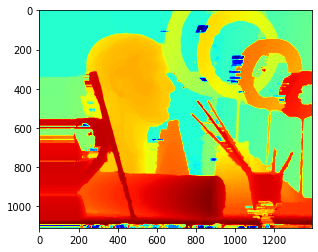

In [ ]:
import matplotlib.pyplot as plt
plt.figure()
plt.imshow(filled_disp, cmap='jet')

In [ ]:
import pypotree
plydata = PlyData.read('out_own_cleaned.ply')

x_arr = np.array(plydata.elements[0].data['x'])
y_arr = np.array(plydata.elements[0].data['y'])
z_arr = np.array(plydata.elements[0].data['z'])
xyz = np.squeeze(np.dstack((x_arr, y_arr, z_arr)))

cloudpath = pypotree.generate_cloud_for_display(xyz)
pypotree.display_cloud_colab(cloudpath)

/usr/local/lib/python3.7/dist-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p 4572a2 --material ELEVATION --edl-enabled --overwrite
https://localhost:23044/point_clouds/pointclouds/4572a2
